<a href="https://colab.research.google.com/github/spe301/311-analysis/blob/main/311_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import files
path_to_file = list(files.upload().keys())[0]

Saving MyLA311_Service_Request_Data_2020.csv to MyLA311_Service_Request_Data_2020.csv


# EDA

1. What is the most common Request Type for each Request Source, as well as overall?

2. Map out the Homeless Encampment removal requests and look for a pattern, are they less concentrated in the San Fernando Valley and Bel Aire / Beverly Crest than the rest of LA?

3. Show us the percentage breakdown of Request Types overall, do this again for Requests that took place within 1/2 mile radius of a school and see if there's any noticeable difference. Also check if the percentage of Anonomys requests is any different.

4. What neighborhood council has the highest number of requests in total, What is the percentage breakdown for request source here?

In [10]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import folium

In [3]:
df = pd.read_csv('MyLA311_Service_Request_Data_2020.csv')
df.head()

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (21) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,SRNumber,CreatedDate,UpdatedDate,ActionTaken,Owner,RequestType,Status,RequestSource,CreatedByUserOrganization,MobileOS,Anonymous,AssignTo,ServiceDate,ClosedDate,AddressVerified,ApproximateAddress,Address,HouseNumber,Direction,StreetName,Suffix,ZipCode,Latitude,Longitude,Location,TBMPage,TBMColumn,TBMRow,APC,CD,CDMember,NC,NCName,PolicePrecinct
0,1-1523593381,01/01/2020 12:02:00 AM,01/07/2020 12:19:00 PM,SR Created,BOS,Illegal Dumping Pickup,Closed,Call,BOS,NaN,N,SLA,01/07/2020 12:00:00 AM,01/07/2020 10:49:00 AM,Y,N,"1500 W SLAUSON AVE, 90047",1500.0,W,SLAUSON,AVE,90047,33.988984,-118.302681,"(33.988984265, -118.302681205)",673.0,J,5.0,South Los Angeles APC,8.0,Marqueece Harris-Dawson,81.0,EMPOWERMENT CONGRESS CENTRAL AREA NDC,77TH STREET
1,1-1523590121,01/01/2020 12:05:00 AM,01/02/2020 08:43:00 AM,SR Created,BOS,Illegal Dumping Pickup,Closed,Call,BOS,NaN,N,WV,01/02/2020 12:00:00 AM,01/02/2020 08:43:00 AM,Y,N,"16815 W VANOWEN ST, 91406",16815.0,W,VANOWEN,ST,91406,34.194028,-118.499472,"(34.1940284578, -118.499471638)",531.0,D,6.0,South Valley APC,6.0,Nury Martinez,19.0,LAKE BALBOA NC,WEST VALLEY
2,1-1523596201,01/01/2020 12:16:00 AM,01/02/2020 03:13:00 PM,SR Created,OCB,Graffiti Removal,Closed,Mobile App,Self Service,Android,N,LACC,01/02/2020 12:00:00 AM,01/02/2020 03:13:00 PM,Y,N,"1848 W BROWNING BLVD, 90062",1848.0,W,BROWNING,BLVD,90062,34.011724,-118.312764,"(34.0117235893, -118.312764174)",673.0,H,2.0,South Los Angeles APC,8.0,Marqueece Harris-Dawson,77.0,EMPOWERMENT CONGRESS NORTH AREA NDC,SOUTHWEST
3,1-1523596222,01/01/2020 12:19:00 AM,01/03/2020 07:02:00 AM,SR Created,BOS,Bulky Items,Closed,Mobile App,Self Service,Android,N,NC,01/03/2020 12:00:00 AM,01/03/2020 07:02:00 AM,Y,NaN,"132 S WESTMORELAND AVE, 90004",132.0,S,WESTMORELAND,AVE,90004,34.072440,-118.287798,"(34.0724397675, -118.287797874)",634.0,A,1.0,Central APC,13.0,Mitch O'Farrell,53.0,RAMPART VILLAGE NC,OLYMPIC
4,1-1523591123,01/01/2020 12:21:00 AM,01/03/2020 03:54:00 PM,SR Created,BOS,Metal/Household Appliances,Closed,Mobile App,Self Service,Android,N,NC,01/03/2020 12:00:00 AM,01/03/2020 03:54:00 PM,Y,NaN,"132 S WESTMORELAND AVE, 90004",132.0,S,WESTMORELAND,AVE,90004,34.072440,-118.287798,"(34.0724397675, -118.287797874)",634.0,A,1.0,Central APC,13.0,Mitch O'Farrell,53.0,RAMPART VILLAGE NC,OLYMPIC


In [5]:
sources = list(np.unique(df['RequestSource']))
counts = []
for source in sources:
  counts.append(len(df.loc[df['RequestSource']==source]))

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


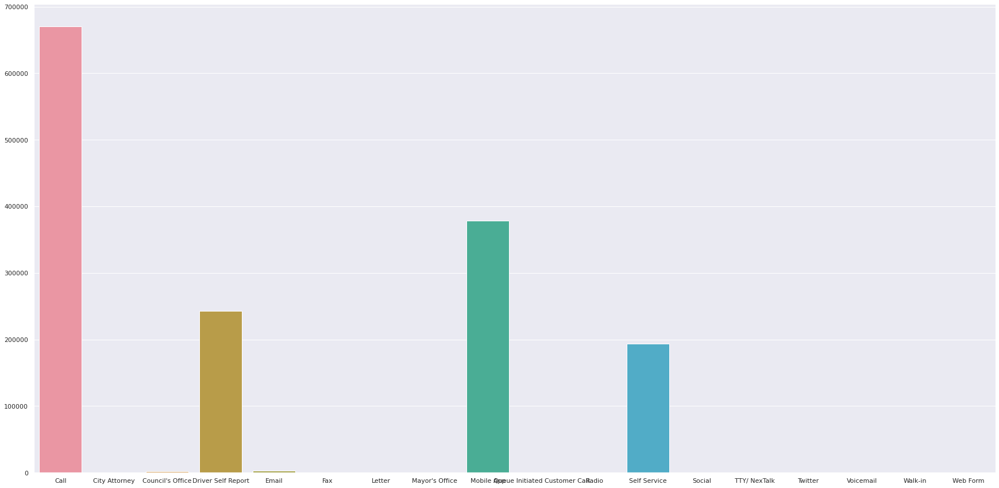

In [6]:
sns.set(rc={'figure.figsize':(30,15)})
sns.barplot(sources, counts)

Conclusion: calls, self reports, the mobile app, and self service are the major sources of requests, with the 15 mediums being extremley rare. Calls are the most common with nearly half the requests being calls.

In [35]:
lat = list(df.loc[df['RequestType']=='Homeless Encampment']['Latitude'].dropna())
lon = list(df.loc[df['RequestType']=='Homeless Encampment']['Longitude'].dropna())

encampments = folium.Map([lat[0], lon[0]], zoom_start = 6)
for i in range(1, 30000):
  num = np.random.randint(0, len(lat))
  folium.Circle([lat[num], lon[num]], radius=2).add_to(encampments)
encampments

Conclusion: The main trend I notice is That the encampments are more concentrated in Southern LA and downtown. While being less concentrated in Santa Monica, Bel Aire, the Pacific Palisades, and the Hollywood Hills are notably less concentrated. This is likley because these areas are more expensive and tend to be higher income.

In [34]:
np.random.randint(0, 5)

2